In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os, warnings
from DCGANs import *

warnings.filterwarnings("ignore")

2022-11-14 15:24:45.454564: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


In [2]:
data_dir = "../input/image-c/img/"
dataset = keras.preprocessing.image_dataset_from_directory(
    data_dir, label_mode=None, image_size=(64, 64), batch_size=64
)
dataset = dataset.map(lambda x: x / 255.0)

Found 26258 files belonging to 1 classes.


2022-11-14 15:25:01.709914: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2022-11-14 15:25:01.713314: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2022-11-14 15:25:01.777026: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-14 15:25:01.777716: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2022-11-14 15:25:01.777775: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2022-11-14 15:25:01.810831: I tensorflow/stream_executor/platform/def

2022-11-14 15:25:04.013073: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2022-11-14 15:25:04.016961: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 2000150000 Hz


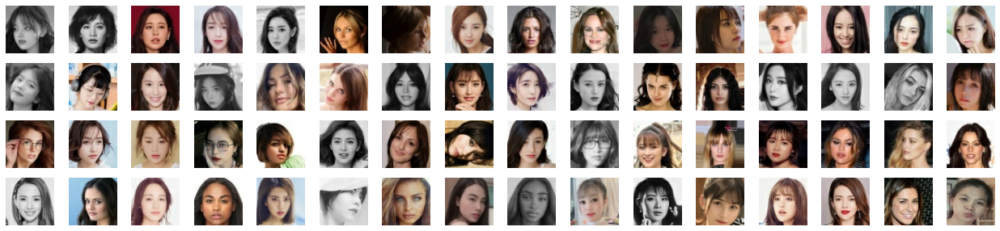

In [3]:
real_batch = next(iter(dataset))
fig, ax = plt.subplots(4, 16, figsize = (22, 5))
ax = ax.ravel()
for k in range(64):
    ax[k].imshow(real_batch[k])
    ax[k].set_axis_off()

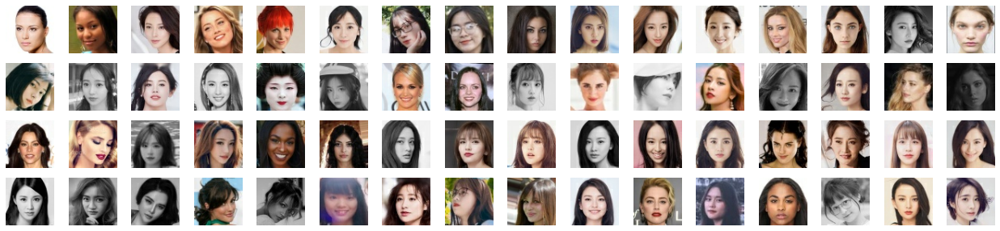

In [4]:
real_batch = next(iter(dataset))
fig, ax = plt.subplots(4, 16, figsize = (22, 5))
ax = ax.ravel()
for k in range(64):
    ax[k].imshow(real_batch[k])
    ax[k].set_axis_off()

In [5]:
discriminator = keras.Sequential(
    [
        keras.Input(shape=(64, 64, 3)),
        layers.Conv2D(64, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2D(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2D(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Flatten(),
        layers.Dropout(0.2),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 128)         262272    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 8192)            

In [6]:
latent_dim = 128
generator = keras.Sequential(
    [
        keras.Input(shape=(latent_dim,)),
        layers.Dense(8 * 8 * 128),
        layers.Reshape((8, 8, 128)),
        layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2DTranspose(512, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2D(3, kernel_size=5, padding="same", activation="sigmoid"),
    ],
    name="generator",
)
generator.summary()

Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 8192)              1056768   
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 128)       262272    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 256)       524544    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 32, 32, 256)       0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 64, 64, 512)       20

In [9]:
epochs = 102  # In practice, use ~100 epochs

gan = GAN(discriminator=discriminator, generator=generator, latent_dim=latent_dim)
gan.compile(
    d_optimizer=keras.optimizers.Adam(learning_rate=0.0001, 
                                      beta_1=0.5, 
                                      beta_2=0.999),
    g_optimizer=keras.optimizers.Adam(learning_rate=0.0001, 
                                      beta_1=0.5, 
                                      beta_2=0.999),
    loss_fn=keras.losses.BinaryCrossentropy(),
)

gan.fit(
    dataset, epochs=epochs, callbacks=[GANMonitor(num_img=36, latent_dim=latent_dim)]
)

Epoch 1/102


2022-11-14 15:25:12.912035: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.11
2022-11-14 15:25:13.848412: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublasLt.so.11
2022-11-14 15:25:13.895042: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudnn.so.8


411/411 [==============================] - 176s 407ms/step - d_loss: 0.6351 - g_loss: 0.8417
Epoch 2/102
411/411 [==============================] - 121s 294ms/step - d_loss: 0.6678 - g_loss: 0.8241
Epoch 3/102
411/411 [==============================] - 123s 298ms/step - d_loss: 0.6661 - g_loss: 0.8242
Epoch 4/102
411/411 [==============================] - 122s 296ms/step - d_loss: 0.6744 - g_loss: 0.8106
Epoch 5/102
411/411 [==============================] - 122s 295ms/step - d_loss: 0.6869 - g_loss: 0.7803
Epoch 6/102
411/411 [==============================] - 121s 294ms/step - d_loss: 0.6842 - g_loss: 0.7857
Epoch 7/102
411/411 [==============================] - 122s 297ms/step - d_loss: 0.6851 - g_loss: 0.7733
Epoch 8/102
411/411 [==============================] - 126s 305ms/step - d_loss: 0.6853 - g_loss: 0.7745
Epoch 9/102
411/411 [==============================] - 127s 308ms/step - d_loss: 0.6853 - g_loss: 0.7699
Epoch 10/102
411/411 [==============================] - 125s 303ms/

In [10]:
import cv2

save_to_vid()

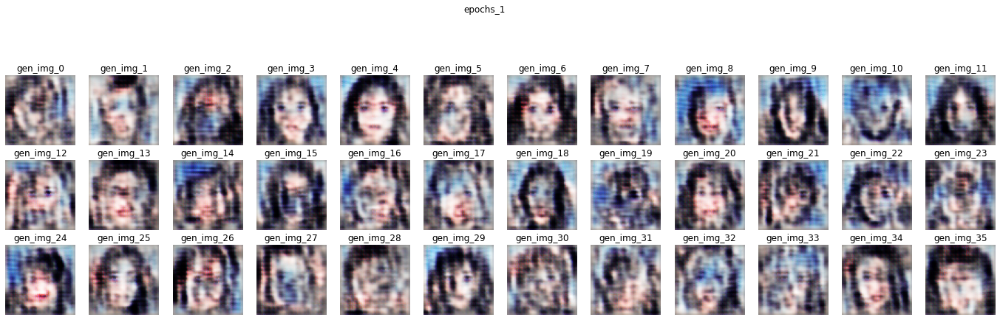

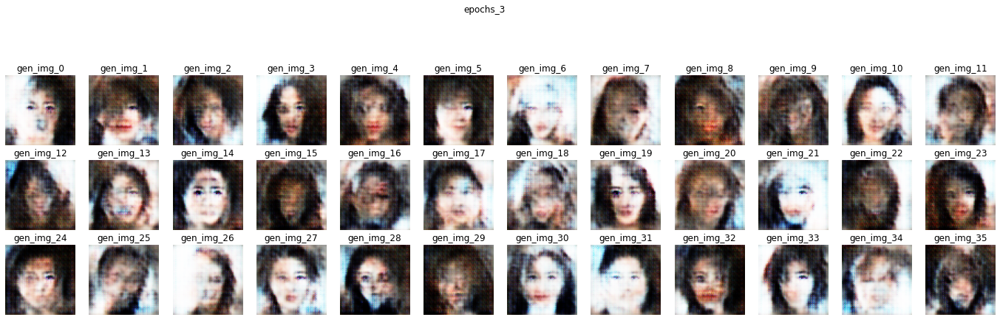

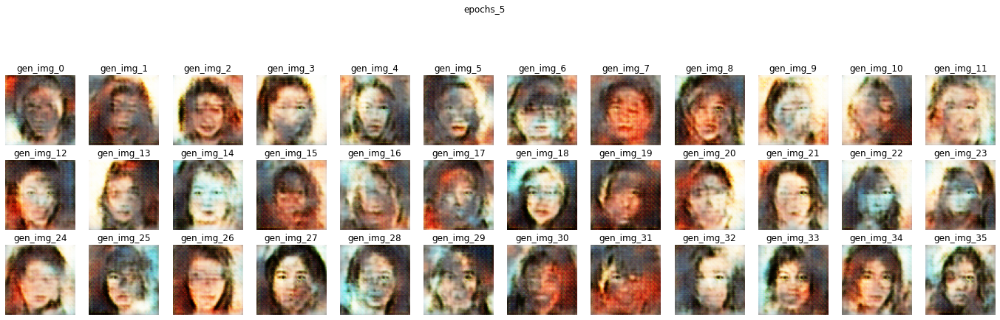

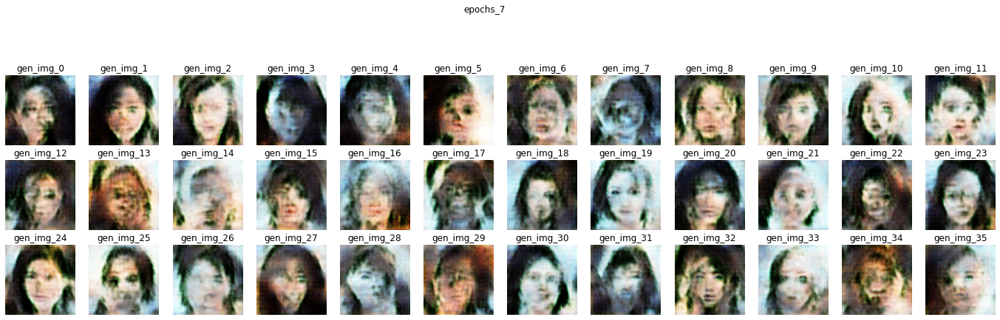

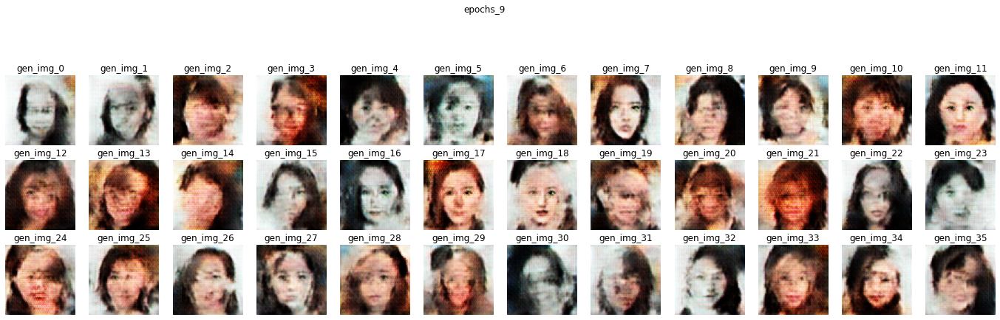

...

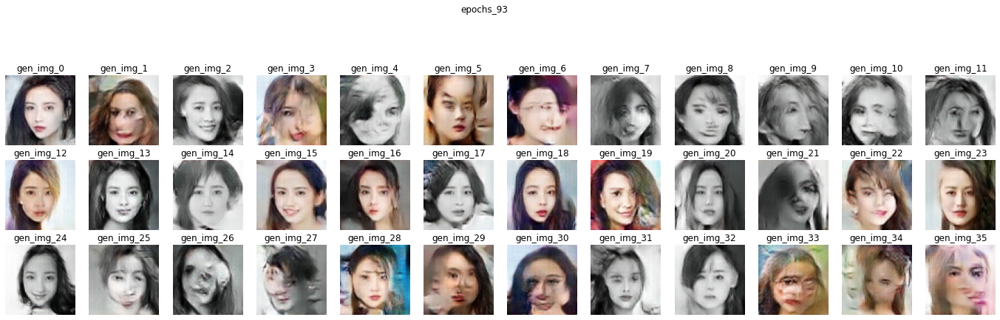

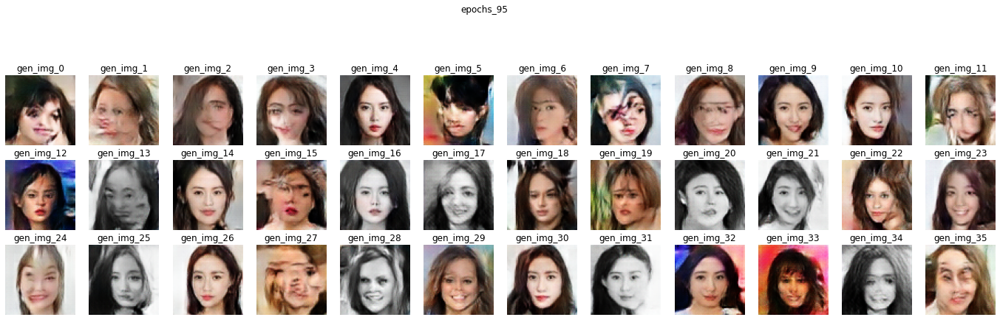

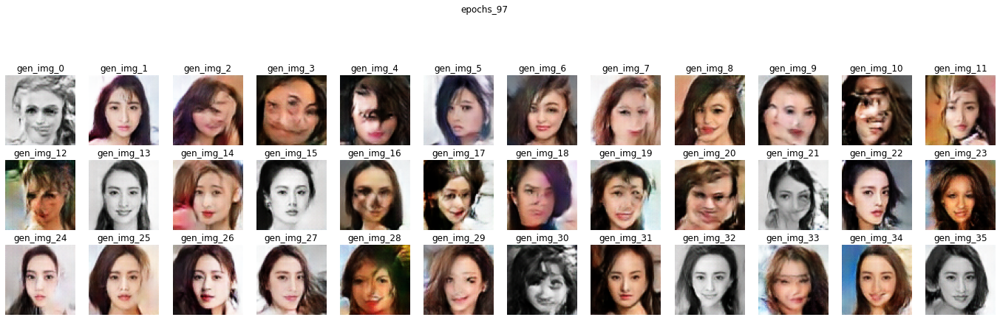

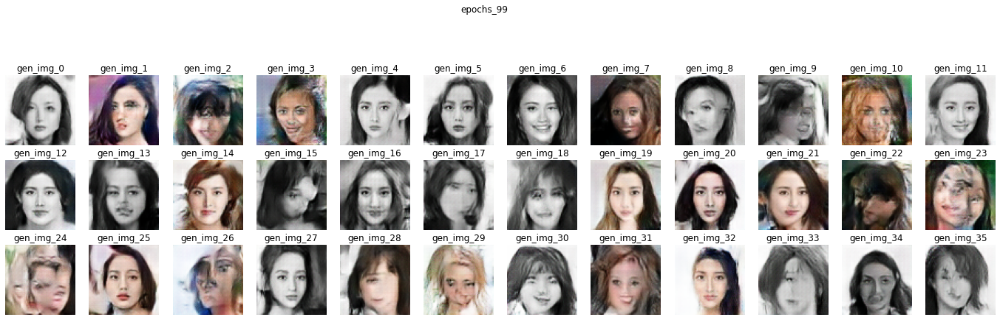

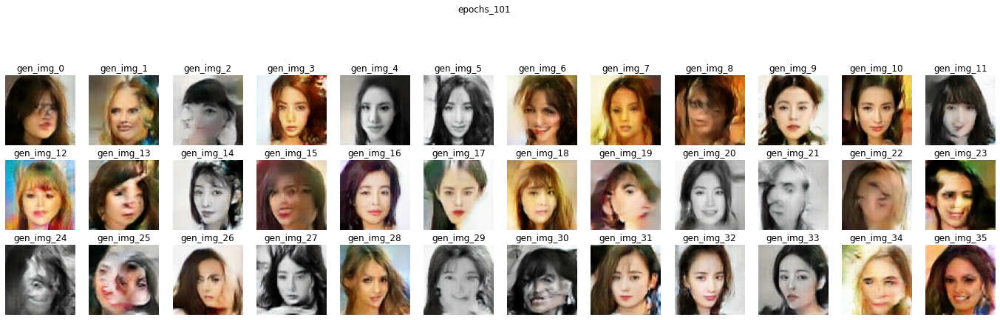

In [11]:
for eps in range(1, epochs, 2):
    epoch_all_img(eps)

### Saving model Gans

In [12]:
gan.save_weights('GANs.h5')